In [5]:
import os
import numpy as np
import open3d as o3d

# 直接从 demo_garment.ply 读取点云，这是 GAM 模型生成 pcd 的来源
# 后面调用仍然可以使用：pcd = load_fold_tops_pcd()
def load_fold_tops_pcd(
    ply_path="Model_HALO/GAM/checkpoints/Tops_LongSleeve/demo_garment.ply",
):
    """从 demo_garment.ply 加载点云并返回 (N, 3) numpy 数组。"""
    # 如果传入的是相对路径，拼到工程根目录下
    if not os.path.isabs(ply_path):
        base_dir = "/home/psibot/DexGarmentLab"
        ply_path = os.path.join(base_dir, ply_path)

    if not os.path.exists(ply_path):
        raise FileNotFoundError(f"找不到点云文件: {ply_path}")

    pcd_o3d = o3d.io.read_point_cloud(ply_path)
    if len(pcd_o3d.points) == 0:
        raise ValueError(f"读取到的点云为空，请检查文件是否正确: {ply_path}")

    points = np.asarray(pcd_o3d.points)  # (N, 3)
    return points



In [6]:
import numpy as np
import open3d as o3d


import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # 只为了触发 3D 支持

def visualize_pcd_with_indices_matplotlib(pcd: np.ndarray,
                                          index_list):
    """
    使用 matplotlib 可视化点云，并在关键点位置标注它们在原始点云中的 index。
    """
    if pcd is None or index_list is None:
        raise ValueError("pcd 和 index_list 不能为空")

    pcd = np.asarray(pcd)
    if pcd.ndim != 2 or pcd.shape[1] != 3:
        raise ValueError(f"pcd 形状应为 (N, 3)，当前为 {pcd.shape}")

    index_array = np.asarray(index_list, dtype=int)
    key_points = pcd[index_array]   # 关键点坐标 (M, 3)

    fig = plt.figure(figsize=(8, 8))
    ax = fig.add_subplot(111, projection='3d')

    # 整体点云（深色，便于观察）
    ax.scatter(
        pcd[:, 0], pcd[:, 1], pcd[:, 2],
        c='black', s=1, alpha=0.8
    )

    # 关键点（红色）
    ax.scatter(key_points[:, 0], key_points[:, 1], key_points[:, 2],
               c='red', s=30)

    # 在关键点位置标 index
    for idx, (x, y, z) in zip(index_array, key_points):
        ax.text(x, y, z, str(int(idx)),
                color='blue', fontsize=10)

    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    ax.set_box_aspect([1, 1, 1])  # 保持比例一致

    # 俯视视角（从上往下）
    ax.view_init(elev=90, azim=-90)

    plt.title("PCD with Manipulation Points (indexed)")
    plt.tight_layout()
    plt.show()



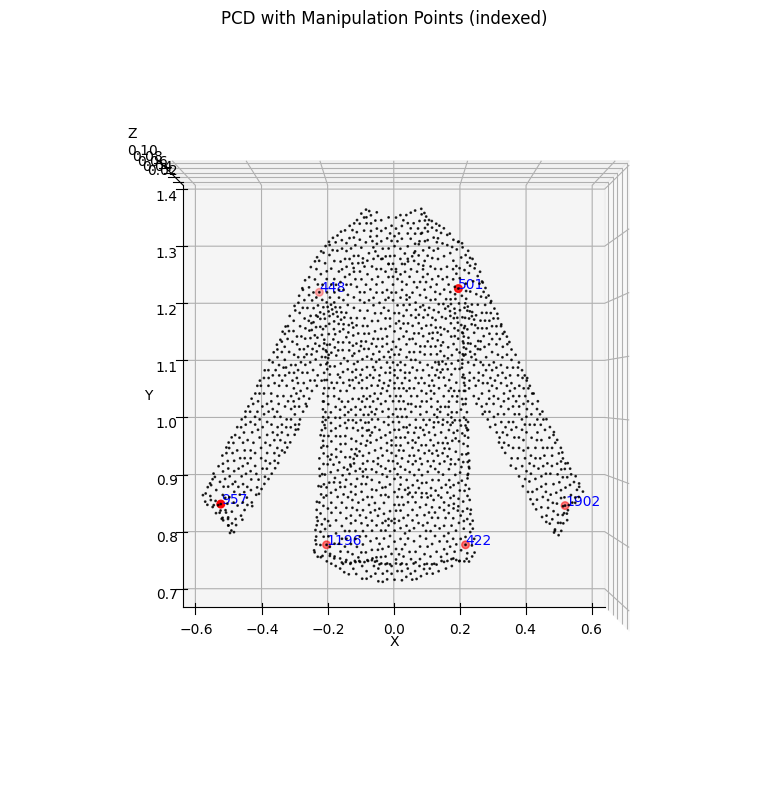

In [7]:
import numpy as np



# ===== 示例用法：可视化 6 个语义点 =====
# pcd 的来源：
# 在 Env_StandAlone/Fold_Tops_Env.py 中，pcd 是通过衣物相机生成的：
#   pcd, color = env.garment_camera.get_point_cloud_data_from_segment(...)
# 并在数据采集时写入 npz 的 'garment_point_cloud' 字段。

# 1. 加载点云
pcd = load_fold_tops_pcd()  # 如需其它样本，修改 npz_path

# 2. 与 Fold_Tops_Env 中一致的 6 个索引
index_list = [957, 501, 1902, 448, 1196, 422]


# 4. 可视化点云 + 6 个关键点
visualize_pcd_with_indices_matplotlib(pcd, index_list)



In [8]:
import numpy as np

data = np.load('Data/Fold_Tops/train_data/data_0.npz', allow_pickle=True)
print(list(data.keys()))

stage1 = data['stage_1']
stage3 = data['stage_3']
frame0 = stage1[0]

print(frame0.keys())              # 看这一帧有哪几个字段
print(frame0['joint_state'].shape)
print(frame0['image'].shape)
print(frame0['env_point_cloud'].shape)
print(frame0['garment_point_cloud'].shape)
print(frame0['points_affordance_feature'].shape)

['usd_path', 'pos', 'ori', 'stage_1', 'stage_2', 'stage_3']
dict_keys(['joint_state', 'image', 'env_point_cloud', 'garment_point_cloud', 'points_affordance_feature'])
(60,)
(480, 640, 3)
(2048, 6)
(2048, 3)
(2048, 2)


In [11]:
import numpy as np

# 从项目根目录运行时的路径
path = "Data/Fold_Tops/train_data/data_0.npz"
data = np.load(path, allow_pickle=True)

print(list(data.keys()))

stage1 = data["stage_1"]
print("stage_1 length:", len(stage1))
stage2 = data["stage_2"]
print("stage_2 length:", len(stage2))
stage3 = data["stage_3"]
print("stage_3 length:", len(stage3))

# 取第一帧看看
frame1 = stage1[0]
print(frame1.keys())

['usd_path', 'pos', 'ori', 'stage_1', 'stage_2', 'stage_3']
stage_1 length: 27
stage_2 length: 27
stage_3 length: 23
dict_keys(['joint_state', 'image', 'env_point_cloud', 'garment_point_cloud', 'points_affordance_feature'])


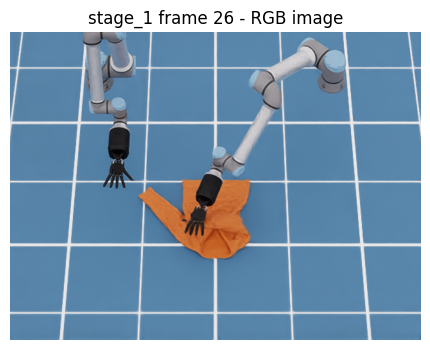

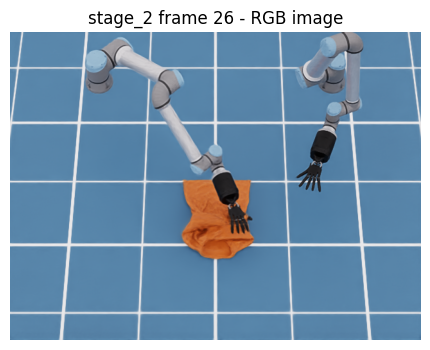

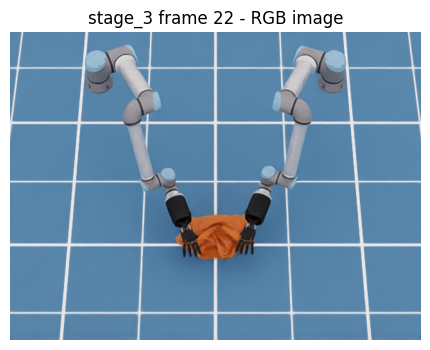

In [13]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

def make_anim(stage, stage_name):
    fig, ax = plt.subplots(figsize=(6, 4))
    im = ax.imshow(stage[0]["image"])
    ax.axis("off")
    ax.set_title(f"{stage_name} frame 0 - RGB image")

    def update(i):
        im.set_data(stage[i]["image"])
        ax.set_title(f"{stage_name} frame {i} - RGB image")
        return im,

    ani = FuncAnimation(fig, update, frames=len(stage), interval=200, blit=False)
    return HTML(ani.to_jshtml())

# 分别生成三个独立视频
html1 = make_anim(stage1, "stage_1")
html2 = make_anim(stage2, "stage_2")
html3 = make_anim(stage3, "stage_3")

# 依次展示三个独立动画
display(html1)
display(html2)
display(html3)

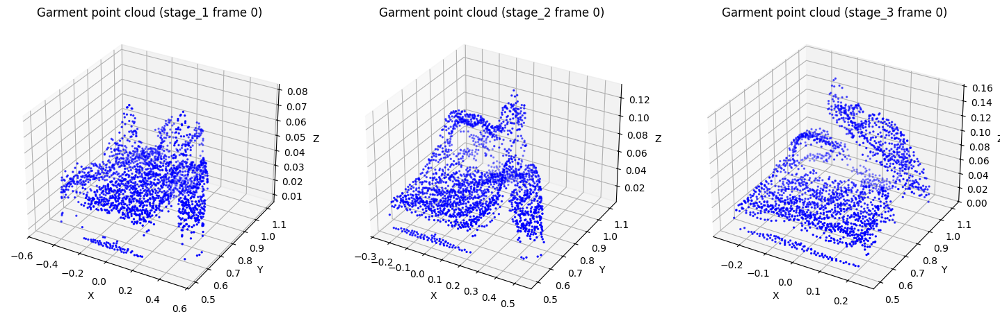

In [14]:
from mpl_toolkits.mplot3d import Axes3D  # 仅用于激活 3D

# 假设每个 stage 是一个列表/数组，这里演示各取第 0 帧
frames = [stage1[0], stage2[0], stage3[0]]
stage_names = ["stage_1", "stage_2", "stage_3"]

fig = plt.figure(figsize=(18, 6))  # 宽一些，一行放三个

for i, (frame, name) in enumerate(zip(frames, stage_names), start=1):
    garment_pc = frame["garment_point_cloud"]   # (2048, 3)

    ax = fig.add_subplot(1, 3, i, projection='3d')
    ax.scatter(
        garment_pc[:, 0], garment_pc[:, 1], garment_pc[:, 2],
        s=2, c='blue'
    )
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.set_title(f"Garment point cloud ({name} frame 0)")

plt.show()

In [ ]:
s1 = data["stage_1"][0]["garment_point_cloud"]
s2 = data["stage_2"][0]["garment_point_cloud"]
s3 = data["stage_3"][0]["garment_point_cloud"]
print(np.allclose(s1, s2), np.allclose(s1, s3))  # 基本会是 False
# 不同stage的点云不相同

False False


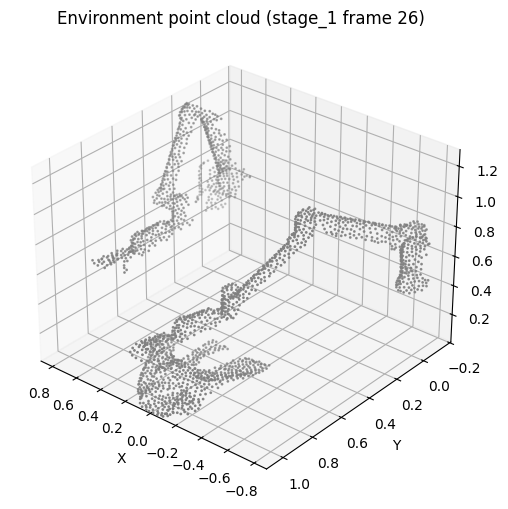

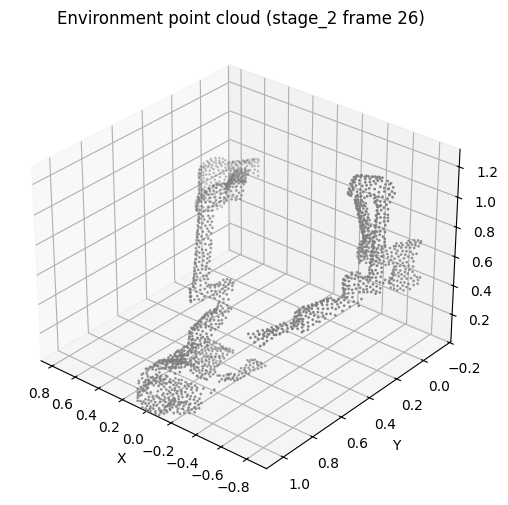

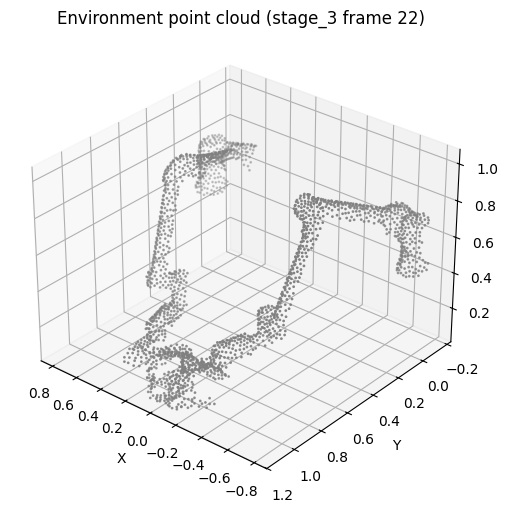

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML, display

from mpl_toolkits.mplot3d import Axes3D  # 激活 3D

def make_env_anim(stage, stage_name):
    # 每帧的 xyz（前 3 维）
    env_pcs = [f["env_point_cloud"][:, :3] for f in stage]
    all_env = np.concatenate(env_pcs, axis=0)

    fig = plt.figure(figsize=(6, 6))
    ax = fig.add_subplot(111, projection='3d')

    ax.view_init(elev=30, azim=130)
    ax.set_xlim(all_env[:, 0].min(), all_env[:, 0].max())
    ax.set_ylim(all_env[:, 1].min(), all_env[:, 1].max())
    ax.set_zlim(all_env[:, 2].min(), all_env[:, 2].max())
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")

    scat = ax.scatter([], [], [], s=1, c='gray')

    def update(i):
        env_pc = env_pcs[i]
        scat._offsets3d = (env_pc[:, 0], env_pc[:, 1], env_pc[:, 2])
        ax.set_title(f"Environment point cloud ({stage_name} frame {i})")
        return scat,

    ani = FuncAnimation(fig, update, frames=len(env_pcs), interval=200, blit=False)
    return HTML(ani.to_jshtml())

# 生成并展示 3 个独立视频控件
html1 = make_env_anim(stage1, "stage_1")
html2 = make_env_anim(stage2, "stage_2")
html3 = make_env_anim(stage3, "stage_3")

display(html1)
display(html2)
display(html3)

In [ ]:
def inspect_env_point_cloud(frame, name=""):
    env_pc = frame["env_point_cloud"]
    print(f"{name} env_point_cloud shape:", env_pc.shape)

    mins = env_pc.min(axis=0)
    maxs = env_pc.max(axis=0)

    for i in range(env_pc.shape[1]):
        print(f"  dim {i}: min={mins[i]:.4f}, max={maxs[i]:.4f}")

    last3 = env_pc[:, -3:]
    in_01   = (last3 >= 0.0).all() and (last3 <= 1.0).all()
    in_255  = (last3 >= 0.0).all() and (last3 <= 255.0).all()

    print("\n最后 3 维是否可能是 RGB：")
    print("  全在 [0, 1] 内？  ", in_01)
    print("  全在 [0, 255] 内？", in_255)
    print("  最后 3 维前 5 个点：")
    print(last3[:5])
    print("-" * 40)

# 分别检查三个阶段的一帧（可以多检查几帧）
inspect_env_point_cloud(stage1[0], "stage_1 frame 0")
inspect_env_point_cloud(stage2[0], "stage_2 frame 0")
inspect_env_point_cloud(stage3[0], "stage_3 frame 0")
# 后3维没有RGB，都是0

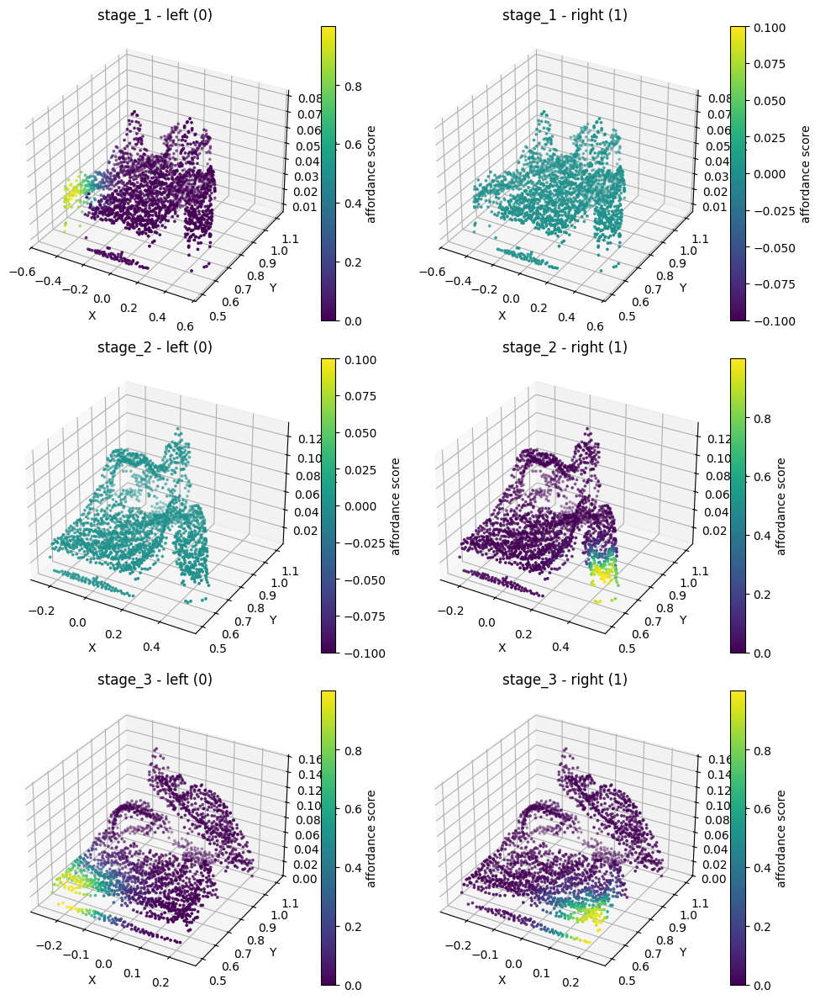

In [ ]:
# 同一 stage 的不同帧的 points_affordance_feature 是一样的
# 不同 stage 的 points_affordance_feature 不一样

stages = ["stage_1", "stage_2", "stage_3"]

# 通道约定：
# 0: 左手 affordance, 1: 右手 affordance, 2: 左手 goal, 3: 右手 goal
channels = [
    ("left",  "affordance", 0),
    ("left",  "goal",       2),
    ("right", "affordance", 1),
    ("right", "goal",       3),
]

fig = plt.figure(figsize=(14, 10))

for i, stage_name in enumerate(stages):
    frame = data[stage_name][0]                        # 每个 stage 取第 0 帧
    garment_pc = frame["garment_point_cloud"]          # (N, 3)
    feat = frame["points_affordance_feature"]          # (N, 4)

    for j, (hand_name, kind, ch_idx) in enumerate(channels):
        score = feat[:, ch_idx]

        ax = fig.add_subplot(
            len(stages),
            len(channels),
            i * len(channels) + j + 1,
            projection="3d"
        )
        p = ax.scatter(
            garment_pc[:, 0], garment_pc[:, 1], garment_pc[:, 2],
            c=score, cmap="viridis", s=3
        )
        ax.set_xlabel("X")
        ax.set_ylabel("Y")
        ax.set_zlabel("Z")

        ax.set_title(f"{stage_name} - {hand_name} {kind}")
        fig.colorbar(p, ax=ax, label=f"{hand_name} {kind} score")

plt.tight_layout()
plt.show()

joint_state shape: (60,)
first 10 values: [-1.5436329e+00 -3.2800331e+00 -2.2741830e+00 -7.3236436e-01
 -1.1965820e+00 -5.0290301e-04 -4.8181184e-02 -5.9326898e-02
 -3.1569585e-01  7.2842851e-02]


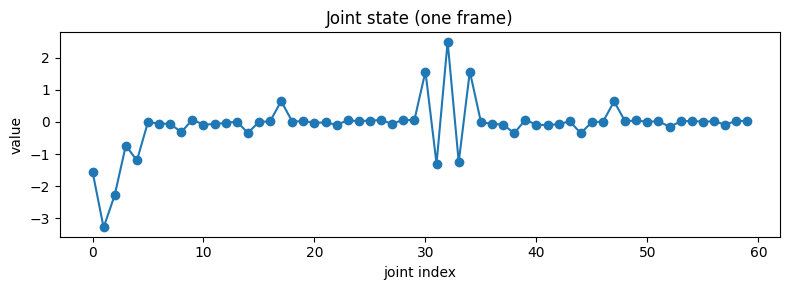

In [18]:
joint_state = frame["joint_state"]   # (60,)

print("joint_state shape:", joint_state.shape)
print("first 10 values:", joint_state[:10])

plt.figure(figsize=(8, 3))
plt.plot(joint_state, marker='o')
plt.title("Joint state (one frame)")
plt.xlabel("joint index")
plt.ylabel("value")
plt.tight_layout()
plt.show()